In [1]:
%matplotlib inline
%config InlineBackend.figure_format = "retina"

# Import standard libraries
import os, sys
import numpy as np
import scipy as sp
import matplotlib as mpl
import matplotlib.pyplot as plt
import copy
import astropy.units as u
import emcee, corner
import seaborn as sns
import pandas as pd

import chimera

import coronagraph as cg
import smart
import smarter; smarter.utils.plot_setup()

/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/locations.py:345: UserWarning: Extinction files not found in /Users/lustija1/Documents/PandExo_data/pysynphot_data/extinction
  warnings.warn('Extinction files not found in %s' % (extdir, ))
/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/refs.py:117: UserWarning: No graph or component tables found; functionality will be SEVERELY crippled. No files found for /Users/lustija1/Documents/PandExo_data/pysynphot_data/mtab/*_tmg.fits
  warnings.warn('No graph or component tables found; '
/Users/lustija1/opt/anaconda3/lib/python3.8/site-packages/pysynphot/refs.py:124: UserWarning: No thermal tables found, no thermal calculations can be performed. No files found for /Users/lustija1/Documents/PandExo_data/pysynphot_data/mtab/*_tmt.fits
  warnings.warn('No thermal tables found, '


In [2]:
#import run_wasp43_mcmc as exopie
#import run_wasp43_mcmc_nontrans as exopie
#import run_wasp43_free_mcmc as exopie
#from run_wasp43_mcmc_niriss import exopie; tag = "test_niriss1"; iburn=400
from run_wasp43_mcmc_nirspec import exopie; tag = "test_nirspec1"; iburn=500
#import run_wasp43_free_mcmc as exopie; tag = "test_free3_data"; iburn=400

Loading Synthetic Data and xsecs...
Loading Synthetic Data and xsecs...


In [3]:
#tag = "test7"; iburn = 4500
#tag = "test9"; iburn = 1500
#tag = "test10"; iburn = 1150
#tag = "test_free1"; iburn=0#iburn = 750

# Create useful things
emcee_backend = str(tag) + "_emcee.h5"
theta_names = exopie.THETA_NAMES
theta0 = exopie.THETA0

# Create an HDF5 backend
backend = emcee.backends.HDFBackend(emcee_backend)

Mean acceptance fraction: 16.06%
Mean autocorrelation time: 380.335 steps


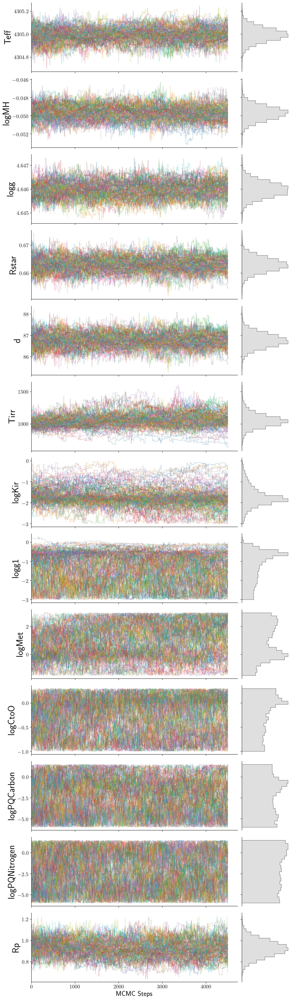

In [4]:
fig, m = smarter.processing.plot_mcmc_trace("example", saveplot=False, iburn0=iburn, 
                                            emcee_backend=backend, labels = theta_names)

for i, ax in enumerate(fig.axes):
    ax.spines["right"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    ax.spines["top"].set_visible(False)
    #ax.set_yticks([])
    plt.setp(ax.xaxis.get_majorticklabels(), rotation=0, fontsize = 14)
    plt.setp(ax.yaxis.get_majorticklabels(), rotation=0, fontsize = 14)
    if i >= len(fig.axes)/2:    
        ax.spines["bottom"].set_visible(False)
        ax.set_xticks([])
        #ax.set_yticklabels([])

fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_trace_%s.png" %tag, bbox_inches = "tight")

In [5]:
# Use all walkers
flatchain = backend.get_chain(flat=True, discard = iburn)
#m = np.sum(np.fabs(flatchain - np.median(flatchain, axis=0)) > 3.0*np.std(flatchain, axis=0), axis =1) == 0

In [103]:
chain = backend.get_chain(flat=False, discard = iburn)
flatchain = chain[:,m,:].reshape((-1, len(theta_names)))

In [171]:
chain = backend.get_chain(flat=False, discard = iburn)
m = np.std(chain, axis=0)[:,-1] > 1.0*np.mean(np.std(chain, axis=0)[:,-1])
flatchain = chain[:,m,:].reshape((-1, len(theta_names)))

In [5]:
# Cut chains by the MAD 
chain = backend.get_chain(flat=False, discard = iburn)
tmp = np.median(chain, axis=0)[:,6]
#np.median(tmp), np.median(np.fabs(tmp - np.median(tmp)))
m = np.fabs(tmp - np.median(tmp)) < 1.5*np.median(np.fabs(tmp - np.median(tmp)))
flatchain = chain[:,m,:].reshape((-1, len(theta_names)))

In [6]:
m.sum(),  m.size

(90, 130)

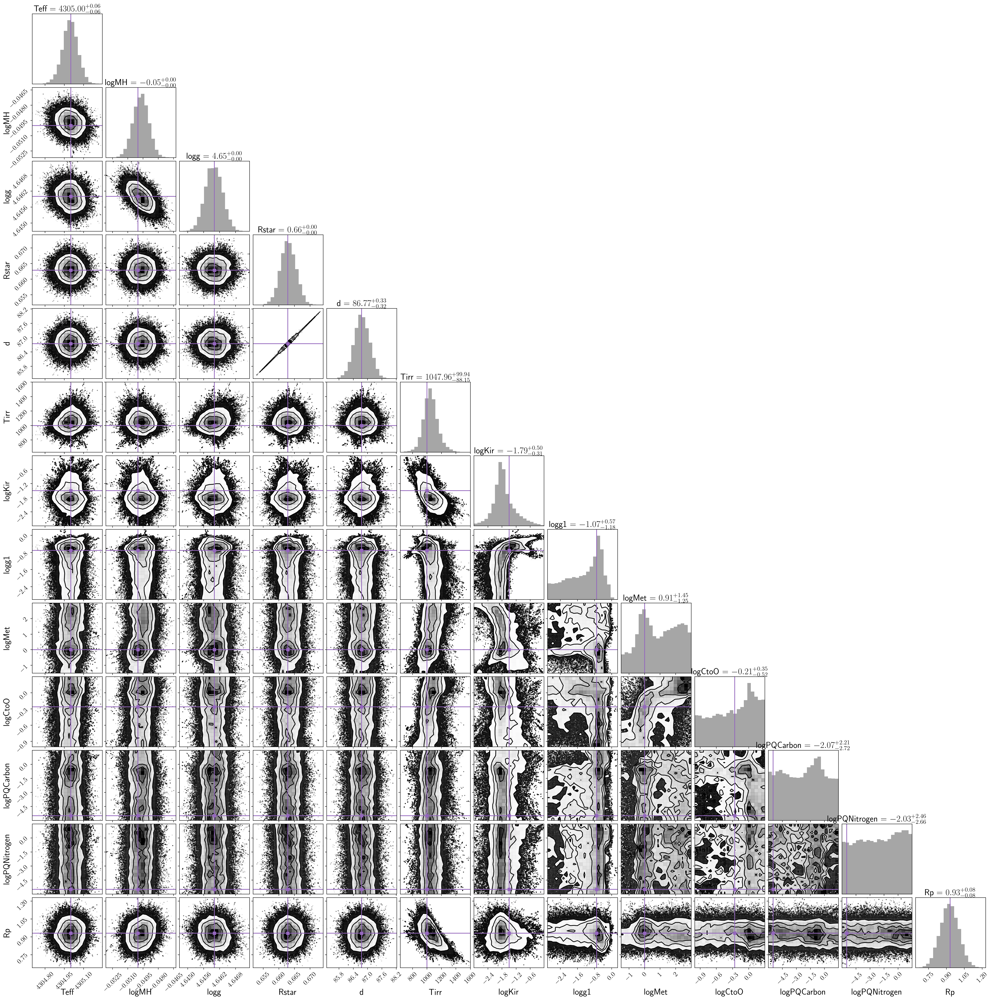

In [6]:
# Make corner plot
fig = corner.corner(flatchain, labels = theta_names, show_titles=True, truths=theta0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s.png" %tag, bbox_inches = "tight")

In [28]:
acor = backend.get_autocorr_time(discard=iburn, quiet = True) 

N/50 = 29;
tau: [128.74589433 125.15773279 128.70732288 133.68249312 133.7311596
 135.75744765 141.13599559 141.11020006 147.09411948 132.35829618
 131.90286711 138.82533999 137.93195399 128.04589827]


In [29]:
print(50 * acor < flatchain.shape[0] / 10)
print((flatchain.shape[0] / 10) / (50 * acor))

[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True]
[3.18177137 3.27298994 3.18272489 3.06427559 3.06316046 3.01744035
 2.90244879 2.90297937 2.78488359 3.09493256 3.10561862 2.95075813
 2.9698702  3.19916534]


## Plot spectra

In [7]:
wl = exopie.wl
y_binned = exopie.y_binned
y_meas = exopie.y_meas
y_err = exopie.y_err

In [8]:
blobs = backend.get_blobs(flat=False, discard = iburn)
Fobs_post, Fstar_post, Fplan_post = blobs[:,m,0,:].reshape((-1, len(wl))), blobs[:,m,1,:].reshape((-1, len(wl))), blobs[:,m,2,:].reshape((-1, len(wl)))

In [48]:
if not backend.has_blobs():

    # Get random samples from posterior
    Nsamples = 1000
    inds = np.random.choice(np.arange(flatchain.shape[0]), size = Nsamples, replace = False)
    theta_samples = flatchain[inds, :]

    # Run model at points
    Fobs_post = np.zeros((Nsamples, len(wl)))
    Fstar_post = np.zeros((Nsamples, len(wl)))
    Fplan_post = np.zeros((Nsamples, len(wl)))
    for i, t in enumerate(theta_samples):
        Fobs_post[i,:], Fstar_post[i,:], Fplan_post[i,:] = run_wasp43_mcmc.run_pie_model_general(t)
        
else:
    
    blobs = backend.get_blobs(flat=True, discard = iburn)
    Fobs_post, Fstar_post, Fplan_post = blobs[:,0,:], blobs[:,1,:], blobs[:,2,:]

In [9]:
# Specify the upper and lower 1- and 3-sigma confidence intervals for the spectra
s1 = 0.6827 # 1-sigma
s2 = 0.9545 # 2-sigma
s3 = 0.9973 # 3-sigma
q1 = [0.5 - 0.5*s1, 0.5, 0.5 + 0.5*s1] # 1-sigma quantiles
q3 = [0.5 - 0.5*s3, 0.5, 0.5 + 0.5*s3] # 3-sigma quantiles

# Calculate percentile spectra (returns: lower bound, median, upper bound)
Fobs_l_1, Fobs_50_1, Fobs_h_1 = np.percentile(Fobs_post, list(100.0 * np.array(q1)), axis=0) # 1-sigma
Fobs_l_3, Fobs_50_3, Fobs_h_3 = np.percentile(Fobs_post, list(100.0 * np.array(q3)), axis=0) # 3-sigma

Fstar_l_1, Fstar_50_1, Fstar_h_1 = np.percentile(Fstar_post, list(100.0 * np.array(q1)), axis=0) # 1-sigma
Fstar_l_3, Fstar_50_3, Fstar_h_3 = np.percentile(Fstar_post, list(100.0 * np.array(q3)), axis=0) # 3-sigma

Fplan_l_1, Fplan_50_1, Fplan_h_1 = np.percentile(Fplan_post, list(100.0 * np.array(q1)), axis=0) # 1-sigma
Fplan_l_3, Fplan_50_3, Fplan_h_3 = np.percentile(Fplan_post, list(100.0 * np.array(q3)), axis=0) # 3-sigma

FpFs_obs_l_1, FpFs_obs_50_1, FpFs_obs_h_1 = np.percentile(y_meas/Fstar_post-1.0, list(100.0 * np.array(q1)), axis=0) # 1-sigma
FpFs_obs_l_3, FpFs_obs_50_3, FpFs_obs_h_3 = np.percentile(y_meas/Fstar_post-1.0, list(100.0 * np.array(q3)), axis=0) # 3-sigma
FpFs_obs_std = 0.5*(FpFs_obs_h_1 - FpFs_obs_l_1)

FpFs_l_1, FpFs_50_1, FpFs_h_1 = np.percentile(Fobs_post/Fstar_post-1.0, list(100.0 * np.array(q1)), axis=0) # 1-sigma
FpFs_l_3, FpFs_50_3, FpFs_h_3 = np.percentile(Fobs_post/Fstar_post-1.0, list(100.0 * np.array(q3)), axis=0) # 3-sigma

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.


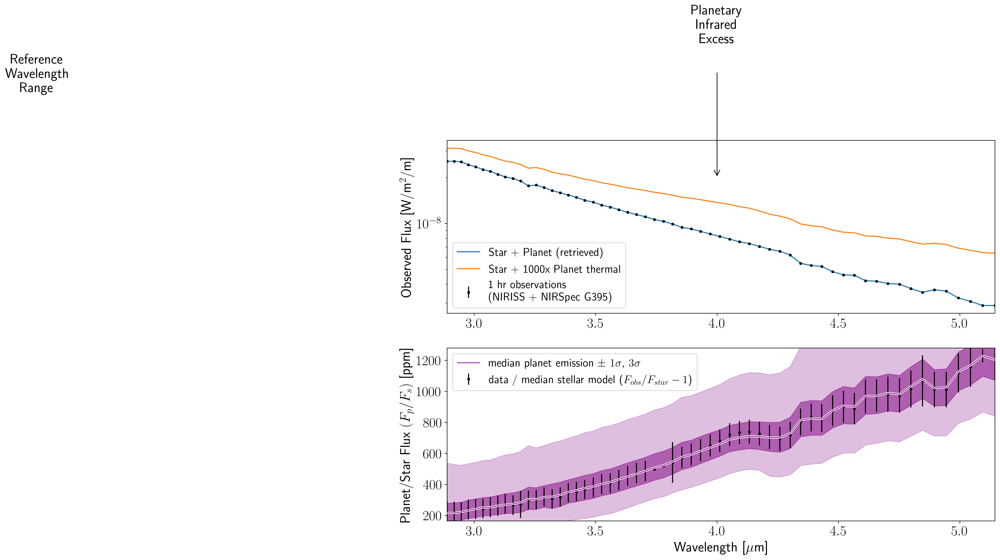

In [10]:
# Plot
fig, axes = plt.subplots(2,1, figsize = (14, 10))
ax= axes[0]
ax2 = axes[1]

ax.set_xlim(wl.min(), wl.max())
ax2.set_xlim(wl.min(), wl.max())
ax2.set_xlabel("Wavelength [$\mu$m]")
ax.set_ylabel("Observed Flux [W/m$^2$/m]")

#ax.plot(wl, y_binned, label = "Star + Planet (truth)", color = "C0")
ax.plot(wl, Fobs_50_1, label = "Star + Planet (retrieved)", color = "C0")
#ax.plot(wl, y_planet, label = "Planet thermal", color = "C3")
ax.errorbar(wl, y_meas, yerr=y_err, fmt = ".k", label = "1 hr observations \n(NIRISS + NIRSpec G395)")
#ax.plot(wl, Fstar_earth + 1000*Fplan_therm_earth, label = "Star + 1000x Planet thermal", color = "C1")
ax.plot(wl, Fstar_50_1 + 1000*Fplan_50_1, label = "Star + 1000x Planet thermal", color = "C1")

ax.set_yscale("log")
ax.legend(fontsize = 16, loc = "lower left")

ax.axvspan(wl.min(), 1.6, color="C2", alpha = 0.1)
ax.text(1.2, 1.3e-7, "Reference\nWavelength\nRange", ha = "center", va = "top")

ax.text(4.0, 2e-7, "Planetary\nInfrared\nExcess", ha = "center", va = "center")
ax.annotate("", xy=(4.0, 2e-8), xytext=(4.0, 1e-7), arrowprops=dict(arrowstyle="->"))

ax2.set_ylabel("Planet/Star Flux $(F_p/F_s)$ [ppm]")
#ax2.plot(wl, 1e6*(y_binned/Fstar_earth-1.0), color = "w", lw = 4.0, zorder = 100)
#ax2.plot(wl, 1e6*(y_binned/Fstar_earth-1.0), color = "C3", label = "Planet-to-Star Flux ($F_{pl}/F_{star}$)", zorder = 100)
#ax2.plot(wl, 1e6*(Fobs/Fstar-1.0), color = "w", lw = 4.0, zorder = 100)

# Plot median spectrum
l1 = ax2.plot(wl, 1e6*FpFs_50_1, lw = 3.0, c="w", zorder = 100, alpha = 1.0)
l2 = ax2.plot(wl, 1e6*FpFs_50_1, lw = 1.0, c="purple", zorder = 100, alpha = 1.0, label = "median planet emission $\pm$ $1 \sigma$, $3 \sigma$")
#ax2.plot(wl, 1e6*(Fobs/Fstar-1.0), color = "C3", label = "Retrieved Planet-to-Star Flux ($F_{pl}/F_{star}$)", zorder = 100)

ylim = ax2.get_ylim()
#ax2.errorbar(wl, 1e6*(FpFs_obs_50_1), yerr = 1e6*np.sqrt((y_err/Fstar_50_1)**2 + (FpFs_obs_std)**2), fmt=".C0")#, label = "propagated error from stellar model")
ax2.errorbar(wl, 1e6*(y_meas/Fstar_50_1-1.0), yerr = 1e6*(y_err/Fstar_50_1), fmt=".k", label = "data / median stellar model ($F_{obs} / F_{star} - 1$)")

# Plot envelopes
ax2.fill_between(wl, 1e6*FpFs_l_1, 1e6*FpFs_h_1, color = "purple", alpha = 0.5)
ax2.fill_between(wl, 1e6*FpFs_l_3, 1e6*FpFs_h_3, color = "purple", alpha = 0.25)

ax2.set_ylim(ylim[0], ylim[1])
ax2.legend(fontsize = 16)
#ax2.set_yscale("log")

fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_spectrum_%s.png" %tag, bbox_inches = "tight")

In [8]:
# Specify the upper and lower 1- and 3-sigma confidence intervals for the spectra
s1 = 0.6827 # 1-sigma
s2 = 0.9545 # 2-sigma
s3 = 0.9973 # 3-sigma
q1 = [0.5 - 0.5*s1, 0.5, 0.5 + 0.5*s1] # 1-sigma quantiles

p_low, p_med, p_high = np.percentile(flatchain, list(100.0 * np.array(q1)), axis=0) # 1-sigma

for i, pname in enumerate(theta_names):
    print(pname, ":", p_med[i], "+/-", 0.5*(p_high[i] - p_low[i]))

Teff : 4305.0007137621915 +/- 0.014636500431606692
logMH : -0.050018528276272164 +/- 6.0945539216844535e-05
logg : 4.646013560425391 +/- 5.1069563695715914e-05
Rstar : 0.6626481304730873 +/- 0.0024590356117521472
d : 86.71345790951335 +/- 0.32173033082855085
Tirr : 1041.5463122747867 +/- 62.86348156962242
logKir : -1.8910379830711188 +/- 0.6927520486600354
logg1 : -0.7789378734970207 +/- 0.7574063168188925
H2O : -6.425050437668245 +/- 5.854904793927127
CH4 : -6.403367242260218 +/- 4.837757875712132
CO : -7.748663747544961 +/- 5.358140562531409
CO2 : -7.947763906256141 +/- 5.243722726853087
NH3 : -5.402749774706335 +/- 4.648963643397288
Rp : 0.9518260121343372 +/- 0.05538565658624783


In [ ]:
np.random.standard_normal(size=)

In [9]:
Fo, Fs, Fp, atm = exopie.run_pie_model_general(p_med)

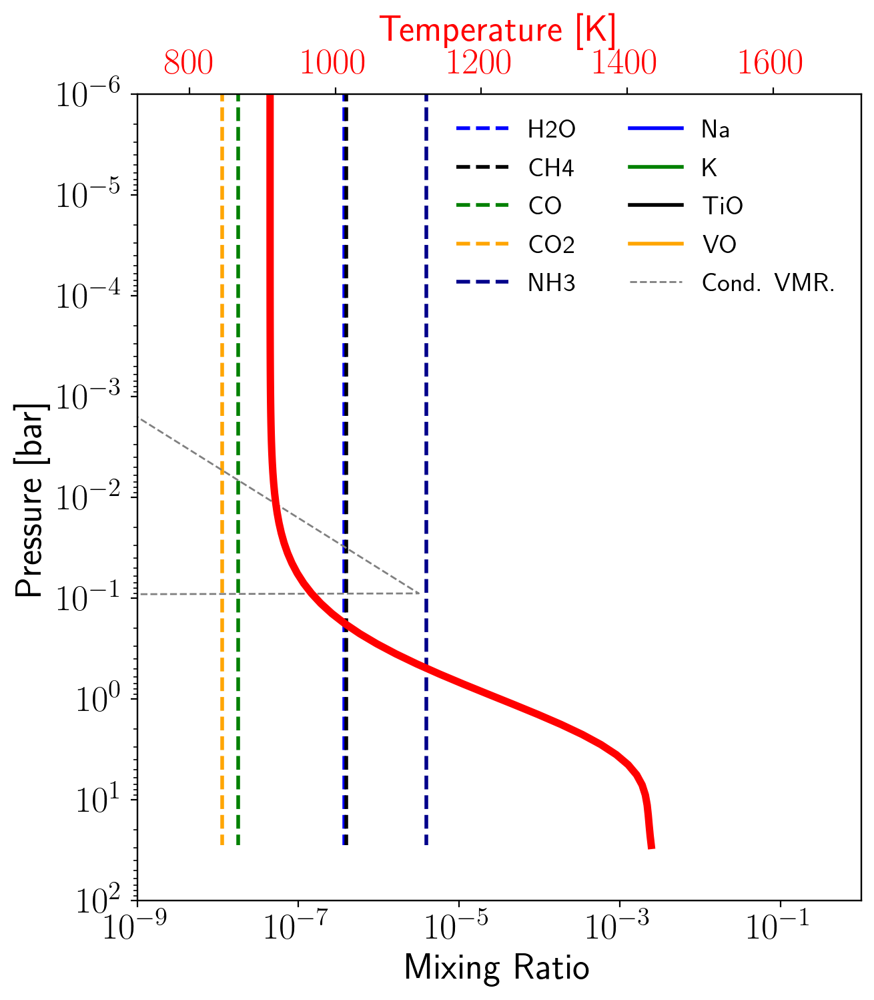

In [24]:
#unpacking variables
#P is in bars
#T is in K
#H2O, CH4,CO,CO2,NH3,Na,K,TiO,VO,C2H2,HCN,H2S,FeH,H2,He are gas mixing ratio profiles
#qc is the condensate abundance profile given an "f_sed" value and cloud base pressure
#r_eff is the effective cloud droplet radius given (see A&M 2001 or Charnay et al. 2017)
#f_r is the mixing ratio array for each of the cloud droplet sizes.
P,T, H2O, CH4,CO,CO2,NH3,Na,K,TiO,VO,C2H2,HCN,H2S,FeH,H2,He,H,e, Hm,qc,r_eff,f_r=atm
Pavg=0.5*(P[1:]+P[:-1])

fig2, ax1= plt.subplots(figsize = (7,8))
#feel free to plot whatever you want here....
ax1.semilogx(H2O,Pavg,'b',ls='--',lw=2,label='H2O')
ax1.semilogx(CH4,Pavg,'black',ls='--',lw=2,label='CH4')
ax1.semilogx(CO,Pavg,'g',ls='--',lw=2,label='CO')
ax1.semilogx(CO2,Pavg,'orange',ls='--',lw=2,label='CO2')
ax1.semilogx(NH3,Pavg,'darkblue',ls='--',lw=2,label='NH3')
ax1.semilogx(Na,Pavg,'b',lw=2,label='Na')
ax1.semilogx(K,Pavg,'g',lw=2,label='K')
ax1.semilogx(TiO,Pavg,'k',lw=2,label='TiO')
ax1.semilogx(VO,Pavg,'orange',lw=2,label='VO')
ax1.semilogx(qc,Pavg,'gray',lw=1,ls='--',label='Cond. VMR.')  #<---- A&M Cloud Condensate VMR profile (not droplets)

ax1.set_xlabel('Mixing Ratio',fontsize=20)
ax1.set_ylabel('Pressure [bar]',fontsize=20)
ax1.semilogy()
ax1.legend(loc=0,frameon=False, fontsize = 14, ncol = 2)
ax1.axis([1E-9,1,100,1E-7])

#plotting TP profile on other x-axis
ax2=ax1.twiny()
ax2.semilogy(Tavg,Pavg,'r-',lw='4',label='TP')
ax2.set_xlabel('Temperature [K]',color='r',fontsize=20)
ax2.axis([0.8*T.min(),1.2*T.max(),100,1E-6])
for tl in ax2.get_xticklabels(): tl.set_color('r')
#ax2.legend(loc=1,frameon=False)

In [100]:
atm2 = copy.deepcopy(atm)

In [101]:
P,T, H2O, CH4,CO,CO2,NH3,Na,K,TiO,VO,C2H2,HCN,H2S,FeH,H2,He,H,e, Hm,qc,r_eff,f_r=atm2
Pavg=0.5*(P[1:]+P[:-1])
Tavg=0.5*(T[1:]+T[:-1])

atm2 = np.vstack([Pavg,Tavg,H2O,CH4,CO,CO2,NH3,Na,K,TiO,VO,C2H2,HCN,H2S,FeH,H2,He,H,e,Hm,qc,r_eff,f_r])

In [102]:
atm2.dtype

dtype('float64')

In [91]:
# Parse 
f_r = atm2[-46:,:]
Pavg,Tavg,H2O,CH4,CO,CO2,NH3,Na,K,TiO,VO,C2H2,HCN,H2S,FeH,H2,He,H,e,Hm,qc,r_eff = atm2[:-46,:]

In [ ]:
exopie

In [218]:
theta_dict = dict(zip(theta_names, theta0))

df = pd.DataFrame(flatchain, columns=theta_names)

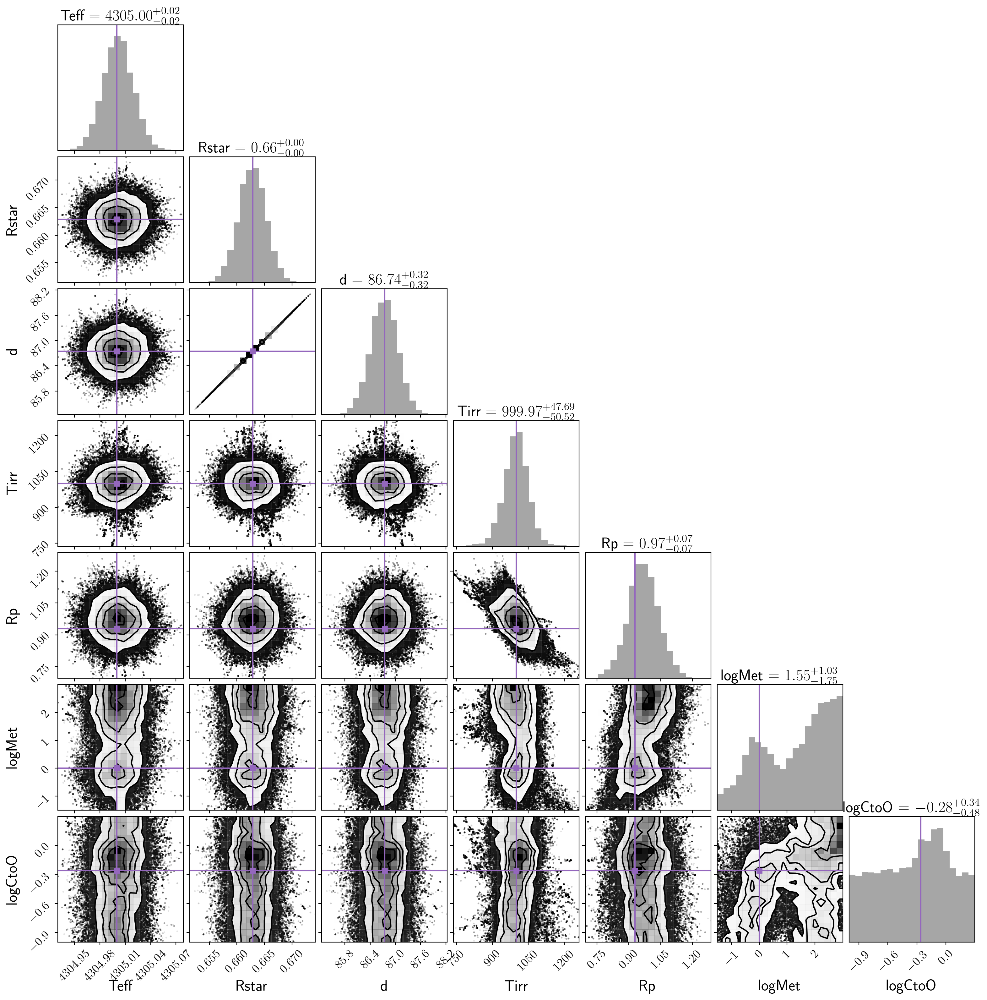

In [219]:
var_names = ["Teff", "Rstar", "d", "Tirr", "Rp", "logMet", "logCtoO"]

t0 = [theta_dict[v] for v in var_names]
vtag = str(var_names).replace(",", "").replace("'", "").replace(" ", "_").replace("[", "").replace("]", "")

# Make corner plot
fig = corner.corner(df[var_names].values, labels = var_names, show_titles=True, truths=t0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s_%s.png" %(tag, vtag), bbox_inches = "tight")

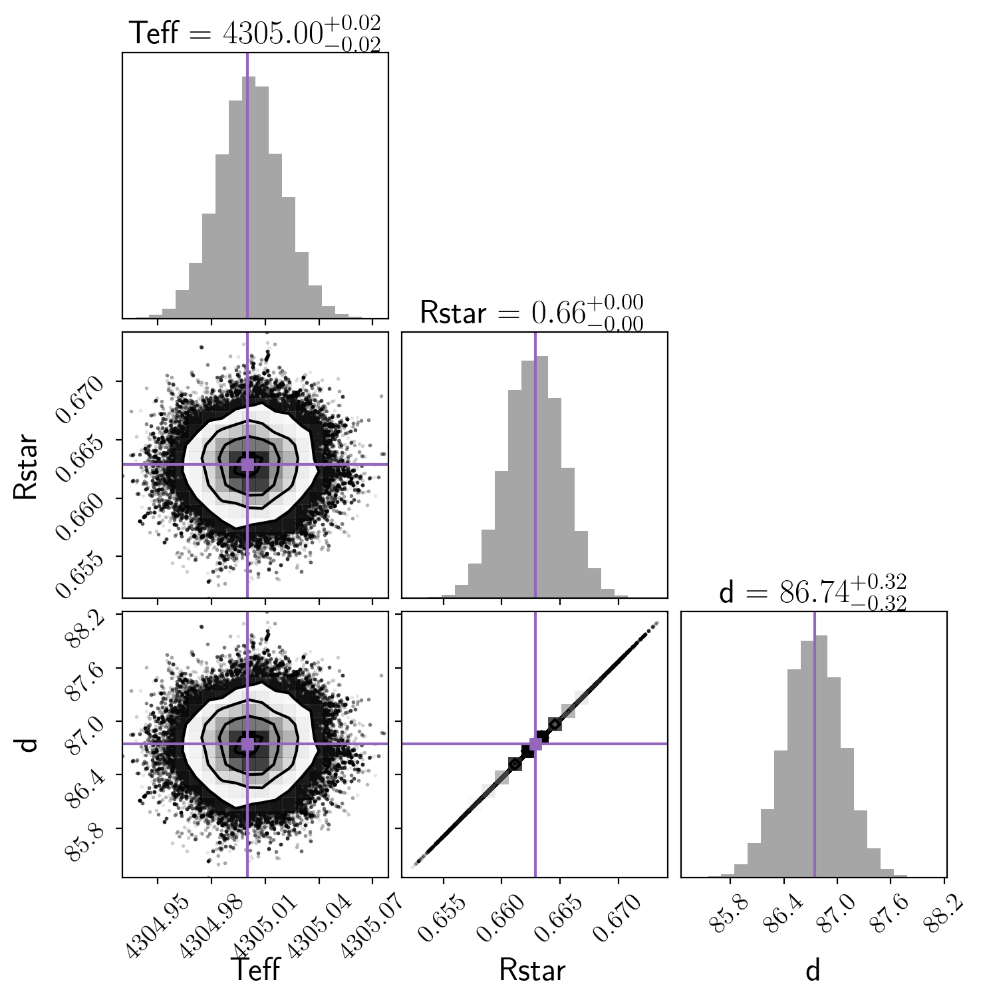

In [220]:
var_names = ["Teff", "Rstar", "d"]

t0 = [theta_dict[v] for v in var_names]
vtag = str(var_names).replace(",", "").replace("'", "").replace(" ", "_").replace("[", "").replace("]", "")

# Make corner plot
fig = corner.corner(df[var_names].values, labels = var_names, show_titles=True, truths=t0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s_%s.png" %(tag, vtag), bbox_inches = "tight")

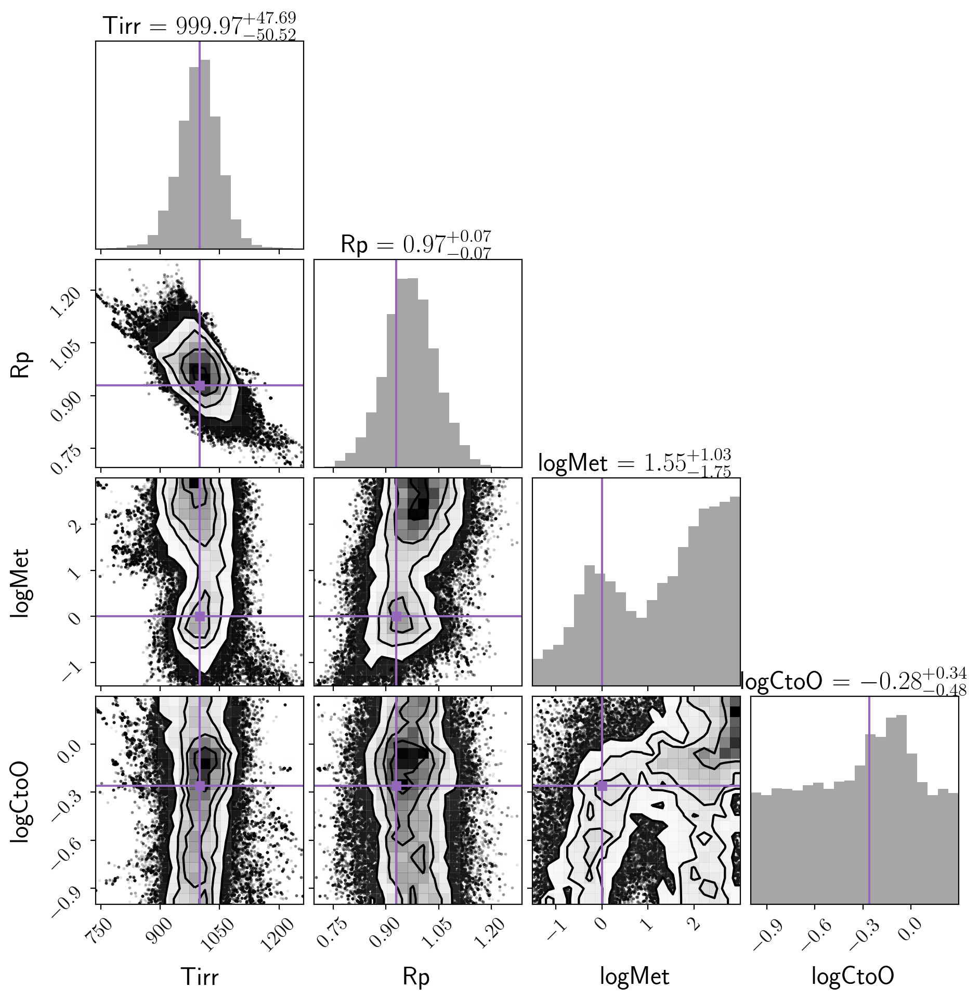

In [221]:
var_names = ["Tirr", "Rp", "logMet", "logCtoO"]

t0 = [theta_dict[v] for v in var_names]
vtag = str(var_names).replace(",", "").replace("'", "").replace(" ", "_").replace("[", "").replace("]", "")

# Make corner plot
fig = corner.corner(df[var_names].values, labels = var_names, show_titles=True, truths=t0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s_%s.png" %(tag, vtag), bbox_inches = "tight")

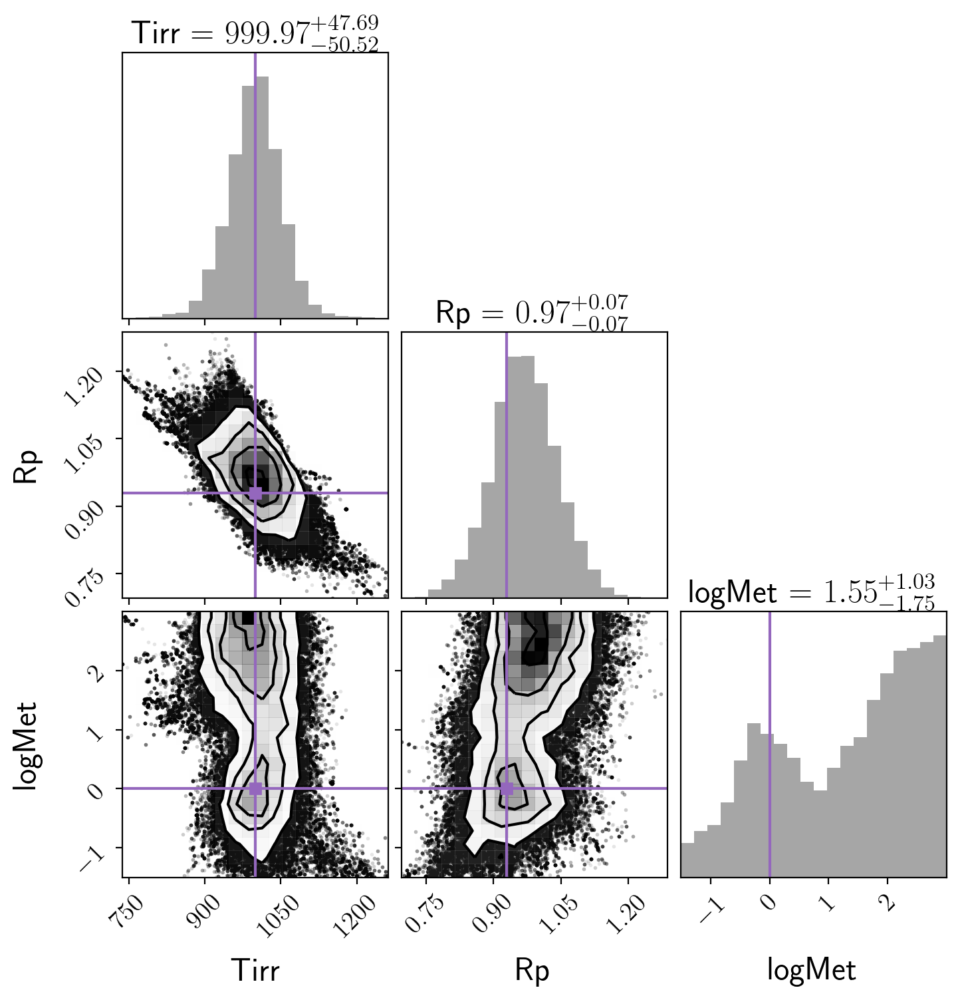

In [222]:
var_names = ["Tirr", "Rp", "logMet"]

t0 = [theta_dict[v] for v in var_names]
vtag = str(var_names).replace(",", "").replace("'", "").replace(" ", "_").replace("[", "").replace("]", "")

# Make corner plot
fig = corner.corner(df[var_names].values, labels = var_names, show_titles=True, truths=t0, truth_color="C4", 
                    hist_kwargs = {"alpha" : 0.35, "histtype" : "stepfilled", "lw" : 1.0, "ls" : "-"})

# Adjust axis labels
for ax in fig.axes:
    ax.xaxis.label.set_fontsize(18)
    ax.yaxis.label.set_fontsize(18)
    ax.title.set_fontsize(18)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(14)
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(14)
        
fig.savefig("/Users/lustija1/Documents/exoPIE_IRAD/W43b_PIE_retrieval_corner_%s_%s.png" %(tag, vtag), bbox_inches = "tight")

## MultiNest Analysis

In [113]:
import pymultinest as pmn
from smarter.processing import multinest_marginals_fancy
import json

n_params = len(run_wasp43_mcmc.PRIORS)

# name of the output files
prefix = os.path.join(tag, "%i-" %n_params)

parameters = theta_names

In [114]:
# Open outputs using Analyzer
a = pmn.Analyzer(n_params = n_params, outputfiles_basename = prefix)

# Get stats from the stats file
s = a.get_stats()

# Extract data
data = a.get_data()
i = data[:,1].argsort()[::-1]
samples = data[i,2:]
weights = data[i,0]
loglike = data[i,1]
Z = s['global evidence']
logvol = np.log(weights) + 0.5 * loglike + Z
logvol = logvol - logvol.max()

# Put crucial data into results dictionary
results = dict(samples=samples, weights=weights, logvol=logvol)

  analysing data from test7/13-.txt


In [116]:
# Make a MultiNest trace plot
fig, axes = multinest_marginals_fancy.traceplot(results,
                                                labels=parameters,
                                                show_titles=False)

# Create color bar on existing figure
rect = [axes[0,0].get_position()._points[0,0],
        axes[0,0].get_position()._points[1,1] + (axes[0,0].get_position()._points[0,1] - axes[1,0].get_position()._points[1,1]),
        axes[0,1].get_position()._points[1,0] - axes[0,0].get_position()._points[0,0],
        0.5*(axes[0,0].get_position()._points[0,1] - axes[1,0].get_position()._points[1,1])]
cax = fig.add_axes(rect)
cbar = fig.colorbar(axes[0,0].collections[0], cax=cax, orientation = "horizontal")
cbar.set_label("Sample Weight ($\mathcal{L}_i w_i / \mathcal{Z}$)",
               labelpad = - 1.5*(axes[0,0].get_position()._points[0,1] - axes[1,0].get_position()._points[1,1]) * fig.dpi * fig.get_size_inches()[1])

# Save plot
fig.savefig(prefix + 'trace.png', bbox_inches='tight')

ValueError: `dataset` input should have multiple elements.

In [11]:
a = np.arange(10)

In [12]:
a

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [20]:
np.concatenate((a, np.array([]), a))

array([0., 1., 2., 3., 4., 5., 6., 7., 8., 9., 0., 1., 2., 3., 4., 5., 6.,
       7., 8., 9.])